## Modify the behavior of the .dot operator

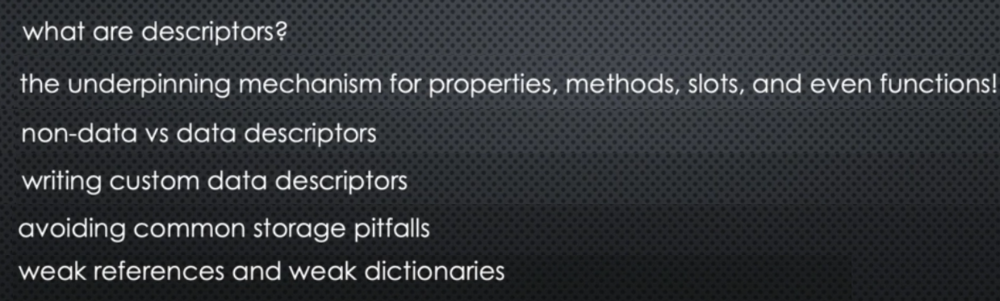

========================
# 1. DATA VALIDATION!
========================

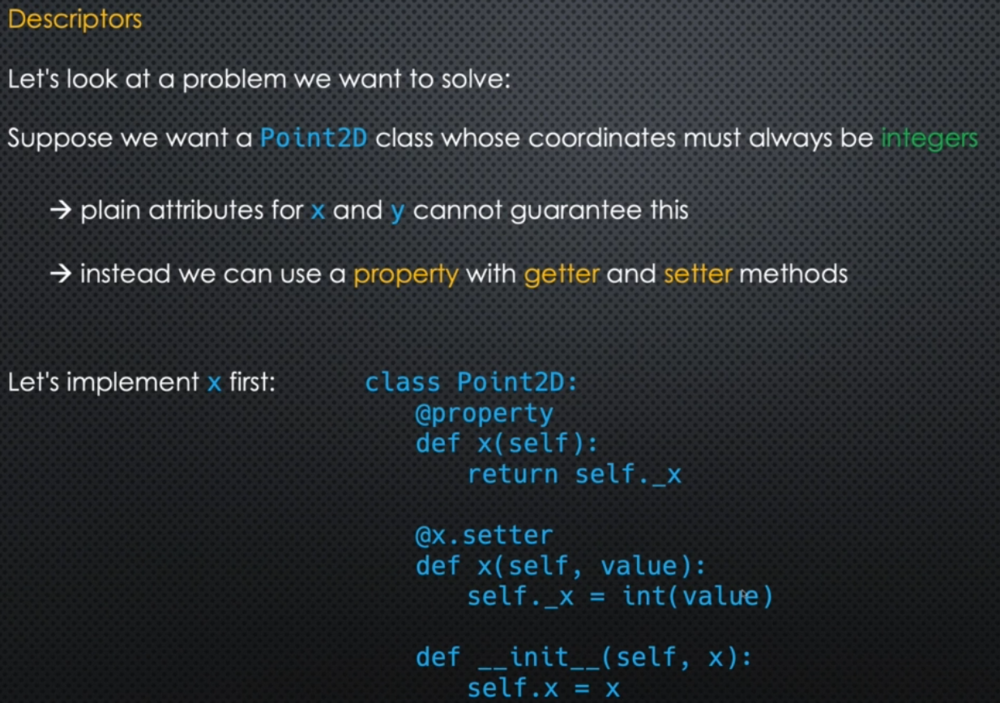

### same for y... repetitive and tedious..

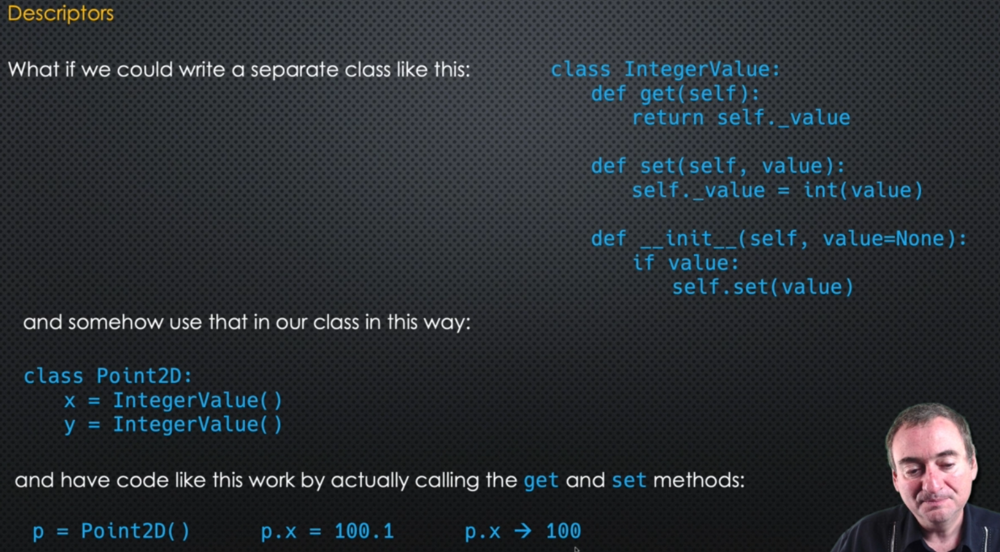

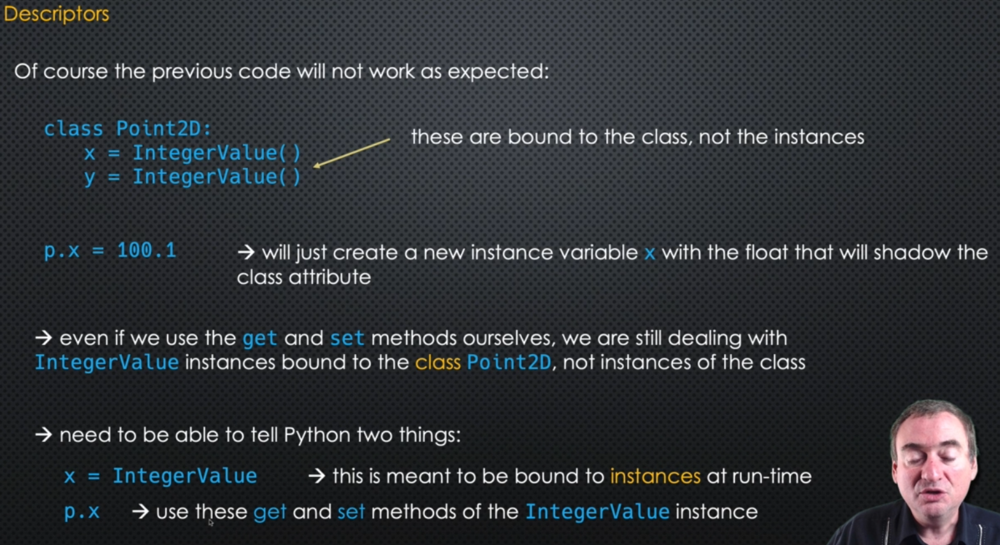

## properties use the descriptor protocol

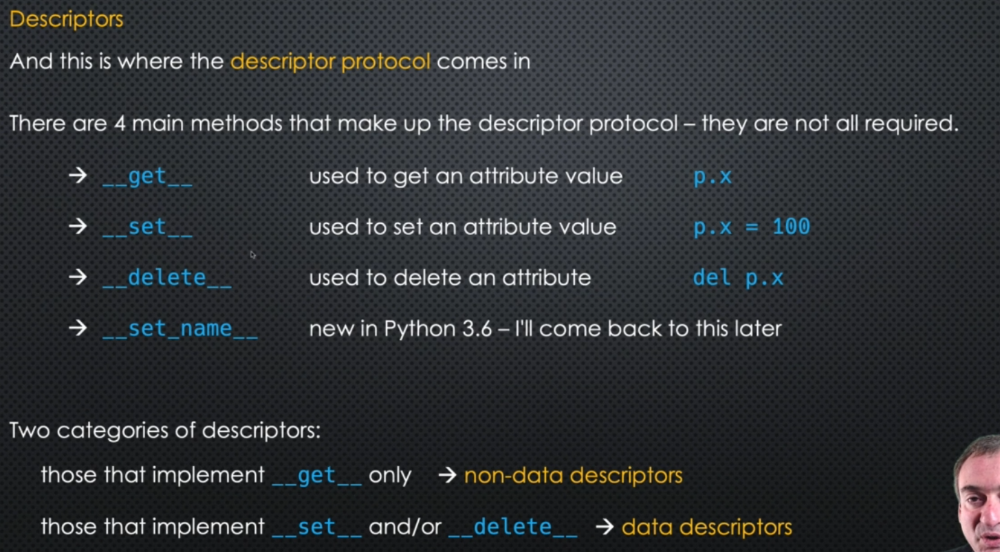

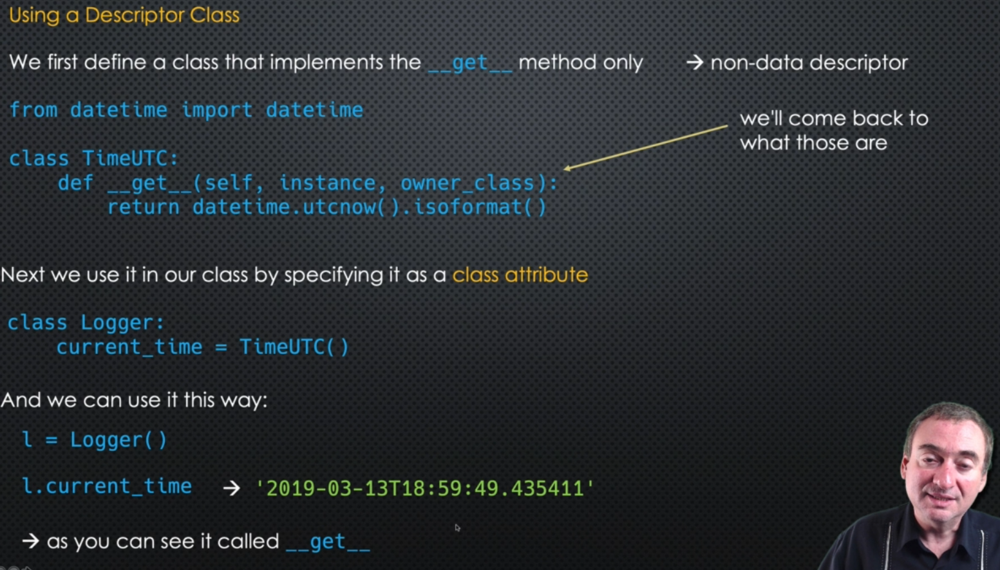

STOP WRITTING HE PROVIDES PDFS!!!!

the current_time works both for the class i.e. 

Logger.current_time 

and well as instances of the class e.g. 

l = Logger()  <br>
l.current_time

========================
# 2. RE-USABILITY!
========================

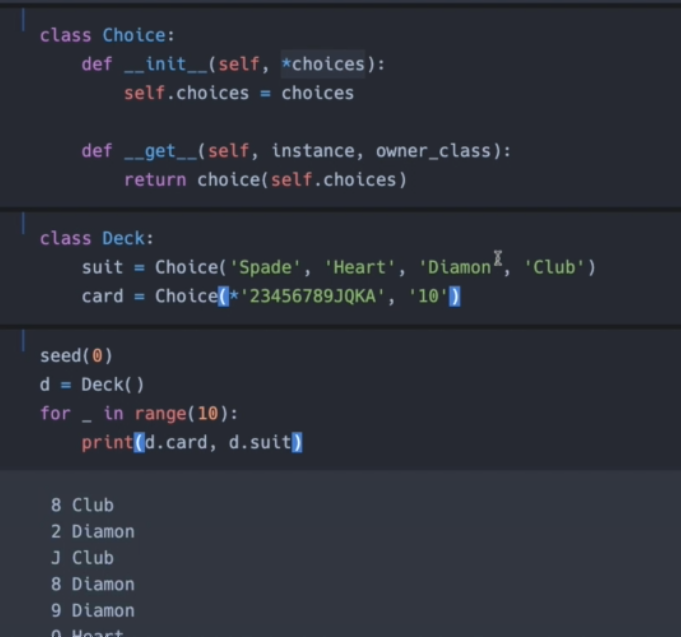

In [2]:
from random import choice, seed

In [4]:
class Choice:
    '''
    DESCRIPTOR
    '''
    def __init__(self, *choices):
        print('Choise instance generated!')
        self.choices = choices
    
    def __get__(self, instance, owner_class):
        print('__get__ called')
        return choice(self.choices)
    
class Deck:
    suit = Choice('Spade', 'Heart', 'Diamond', 'Club')
    card = Choice(*'23456789JKQA', '10')

Choise instance generated!
Choise instance generated!


In [5]:
d = Deck()

In [6]:
for _ in range(5):
    print(d.card, d.suit)

__get__ called
__get__ called
K Club
__get__ called
__get__ called
Q Club
__get__ called
__get__ called
9 Heart
__get__ called
__get__ called
A Heart
__get__ called
__get__ called
2 Club


In [7]:
class Dice:
    die1 = Choice(1,2,3,4,5,6)
    die2 = Choice(1,2,3,4,5)
    die3 = Choice(1,2,3,4)

Choise instance generated!
Choise instance generated!
Choise instance generated!


In [8]:
dice = Dice()

In [9]:
for _ in range(5):
    print(dice.die1, dice.die2, dice.die3)

__get__ called
__get__ called
__get__ called
3 4 1
__get__ called
__get__ called
__get__ called
5 3 1
__get__ called
__get__ called
__get__ called
6 5 4
__get__ called
__get__ called
__get__ called
1 4 3
__get__ called
__get__ called
__get__ called
4 4 1


## NON-data descriptor is equivalent to read-only property but with additional customization and flexibility

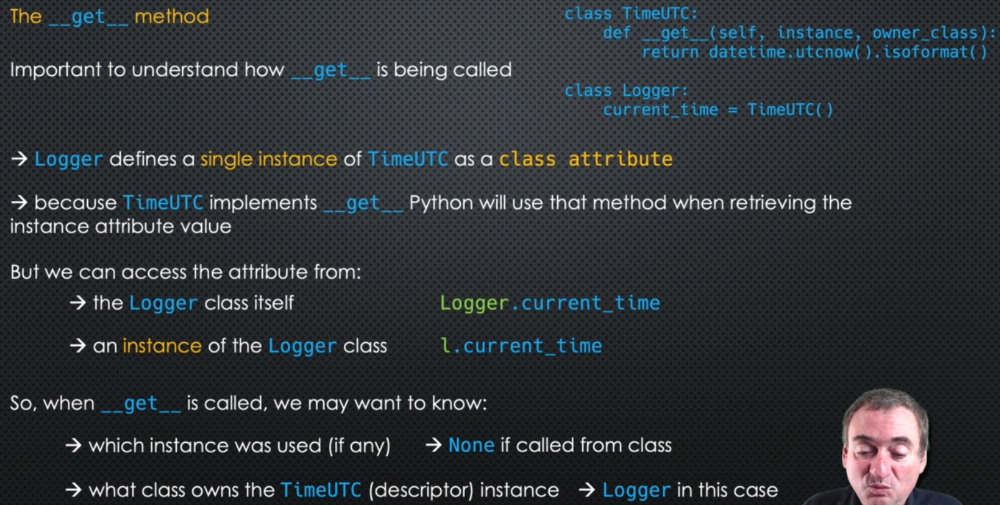

### Which class does this descriptor belong to?? (the last ->)

### self is DESCRIPTOR INSTANCE the instnace of TimeUTC i.e. current_time (i.e. TimeUTC())

### instance: l or None depending if TimeUTC was called from instance of Logger or the Logger its self
### owner_class: is Logger in both cases since current_time belongs in Logger

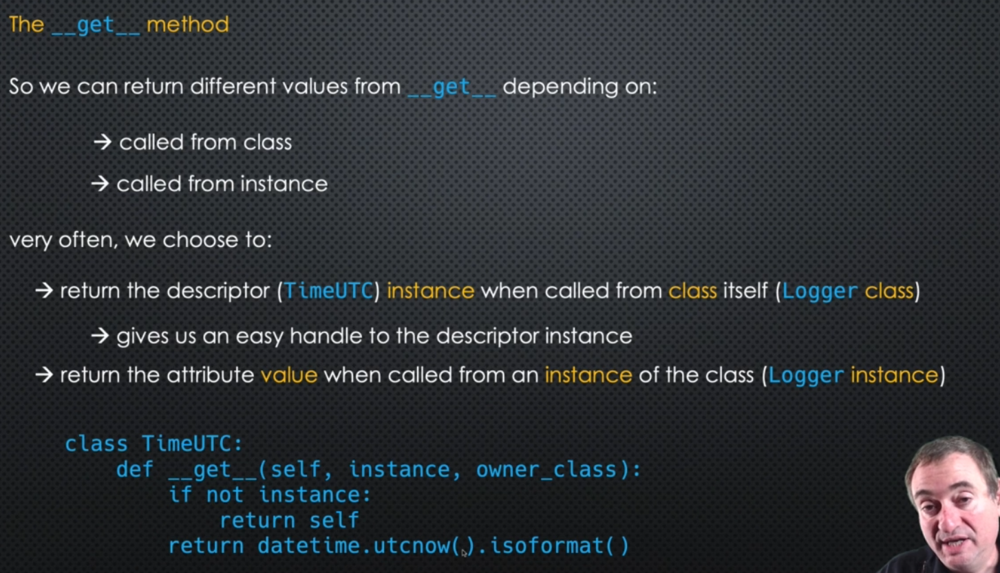

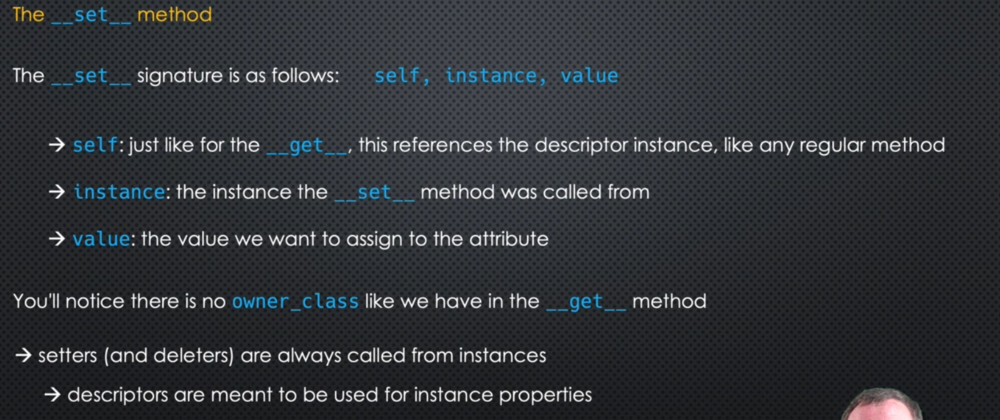

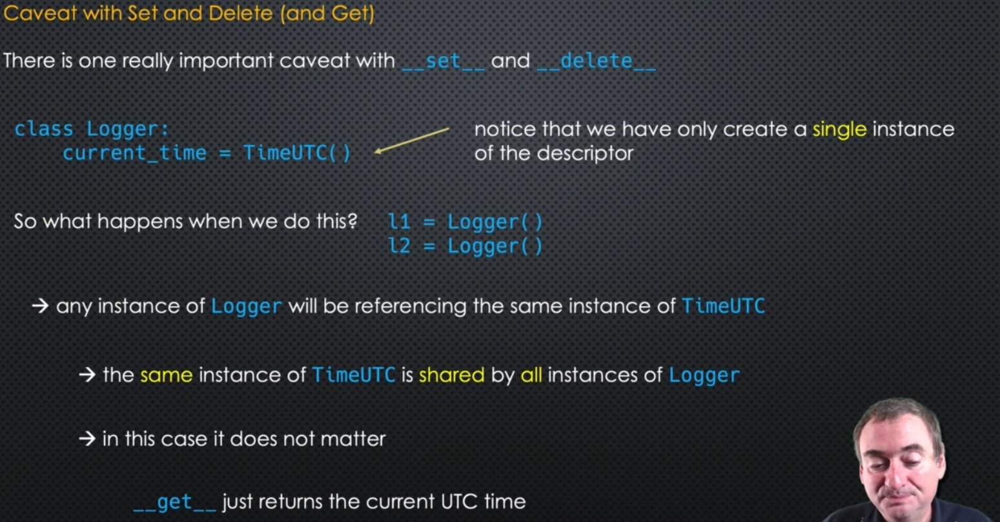

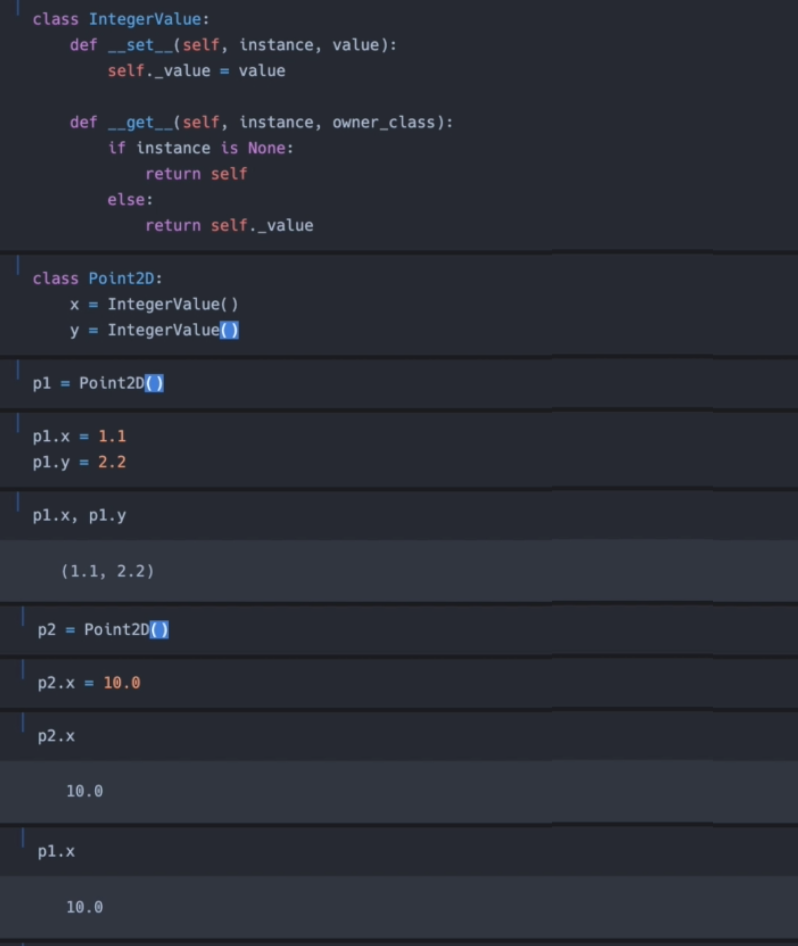

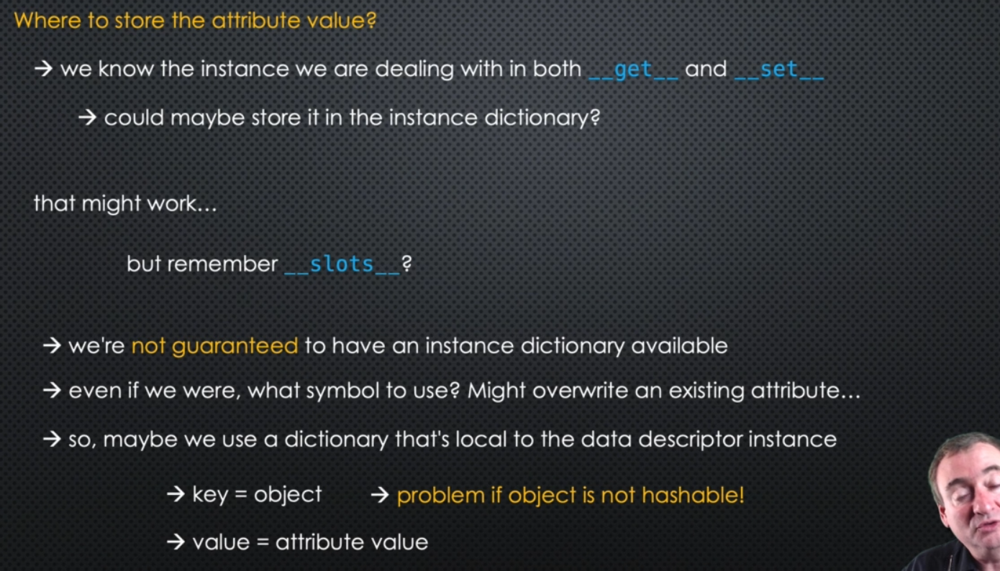

## See 6.1 Notes !!!
etc....


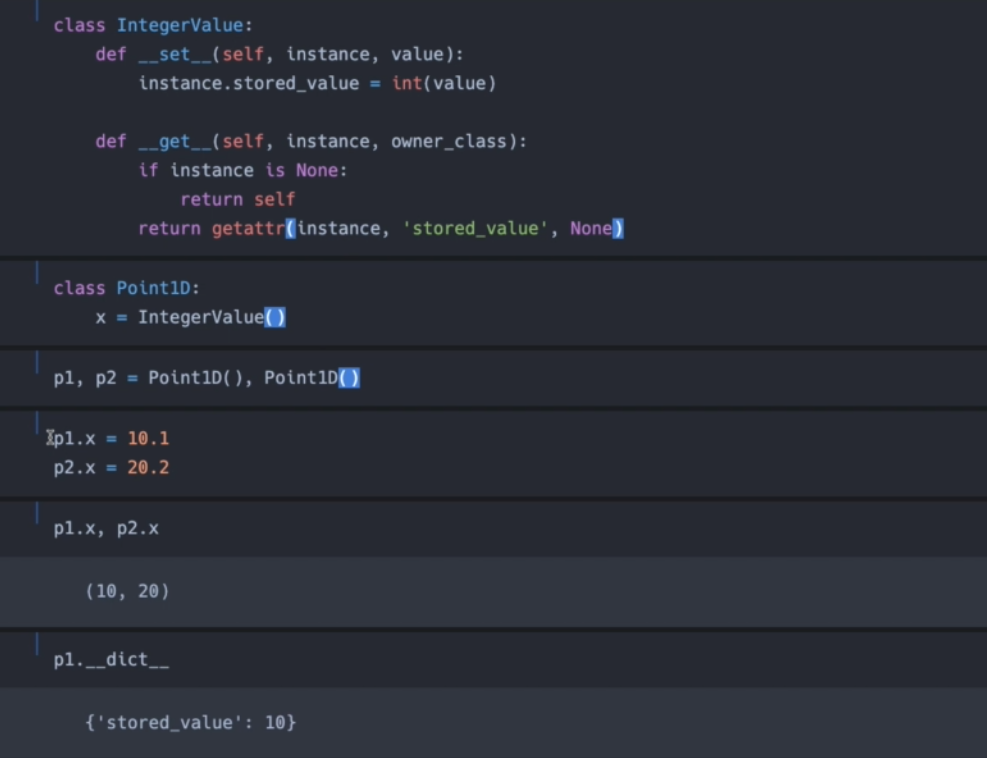

## DOESN'T WORK FOR MULTIPLE INSTANCES OF THE SAME DESCRIPTOR INSIDE THE SAME CLASS
## IF I CREATE AN INSTANCE OF A CLASS THAT HAS 2 INSTANCES OF DATA DESCRIPTOR THEY SHARE THE ATTRIBUTE NAME!!!
## BE CAREFULL!!

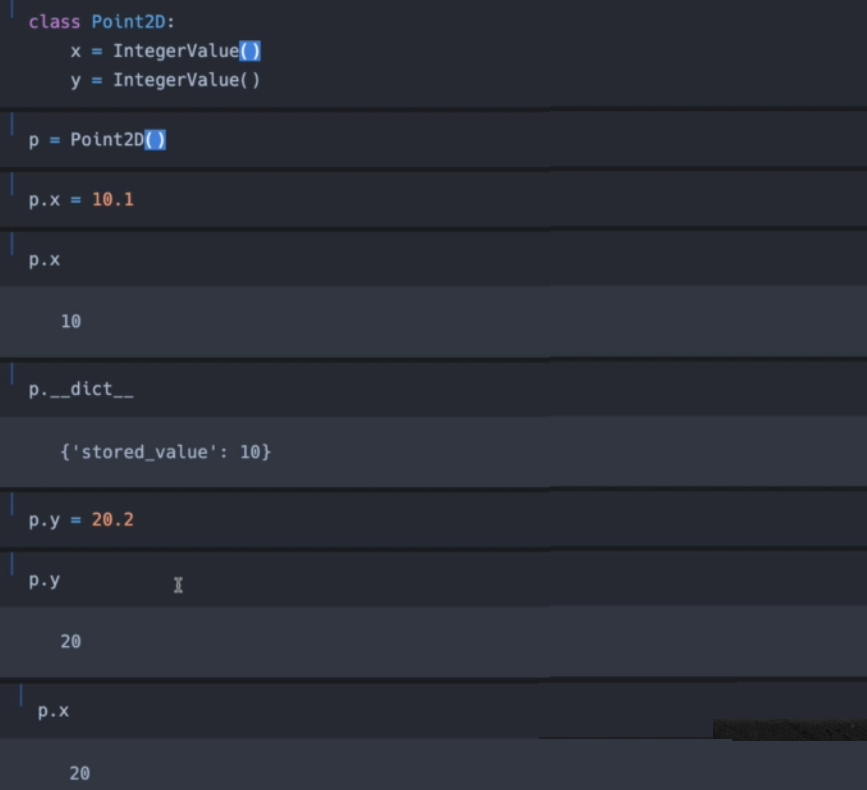

## ONE FIX WITH NAME ATTRIBUTES PASS AT CREATION

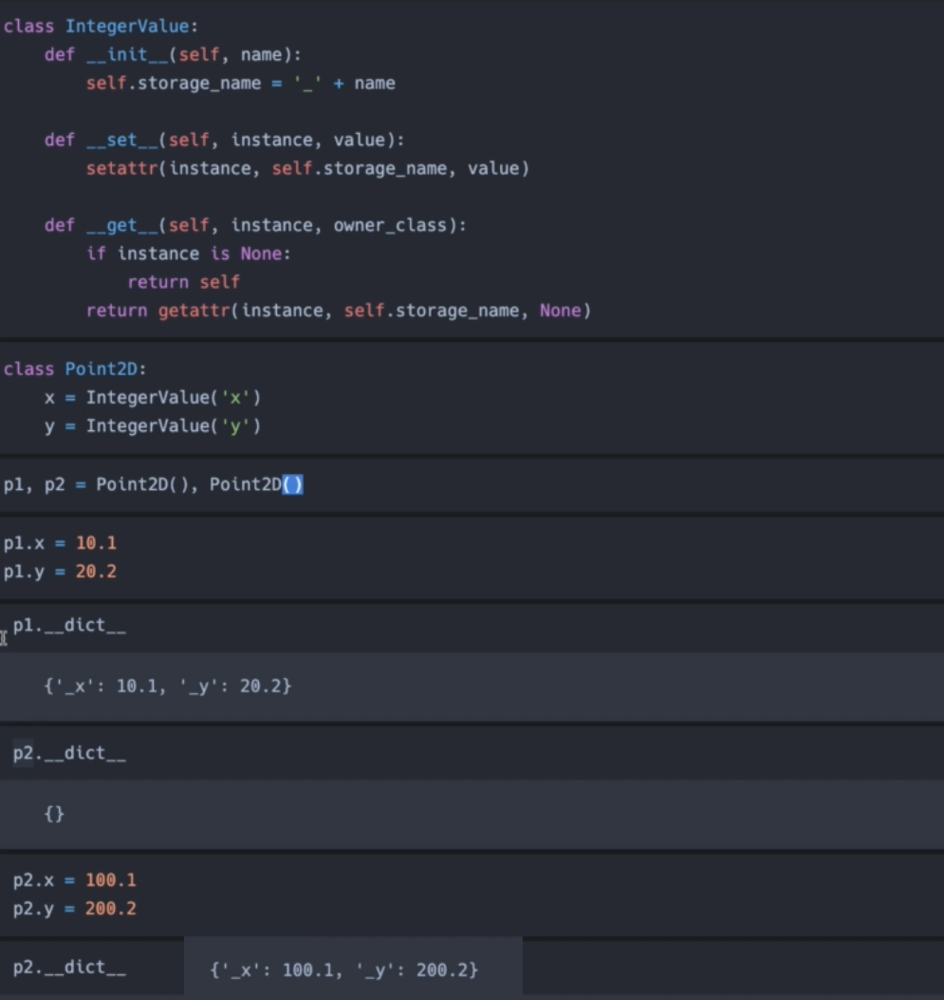

In [ ]:
p1.__dict__ still remains {10.1, 20.2}

## Drawbacks
- use x twice in definition
- we are assuming the user does not already use _x in their code as attribute.. If they did, it would be overriden
- if instance uses slots we cannot setattr() in dunder set

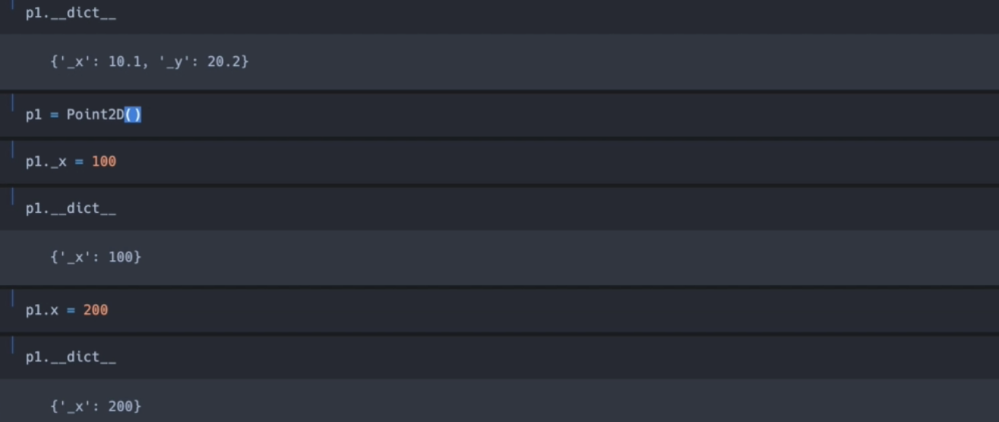

In [ ]:
## Maybe use 
x = IntegerValue('_x')
y = IntegerValue('_y')

## If class is hashable and instance is slotted, then just store it in descriptor instance dictionary (Create storage inside the descriptor)

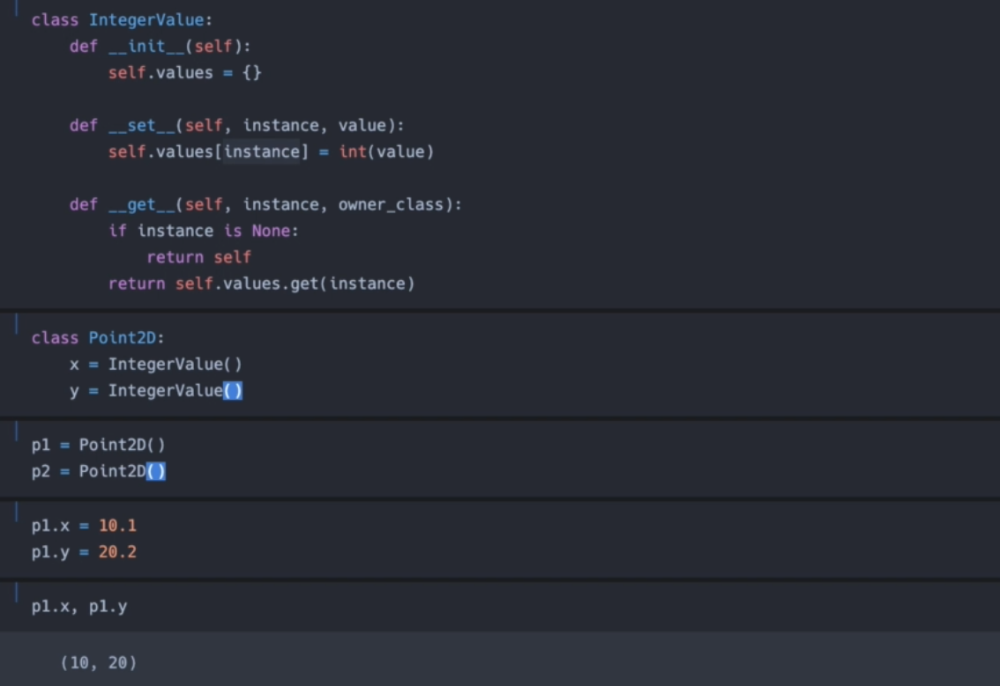

### We are using the same descriptor class but 2 different instances x, y. Each instance will have its own dictionary values = {} but each of those dictionaries are gonna store the values based on the instance of the Point2D

## Point2D.x  --> returns self i.e. instance of the descriptor
## Point2D.x.values  --> returns dictionary values

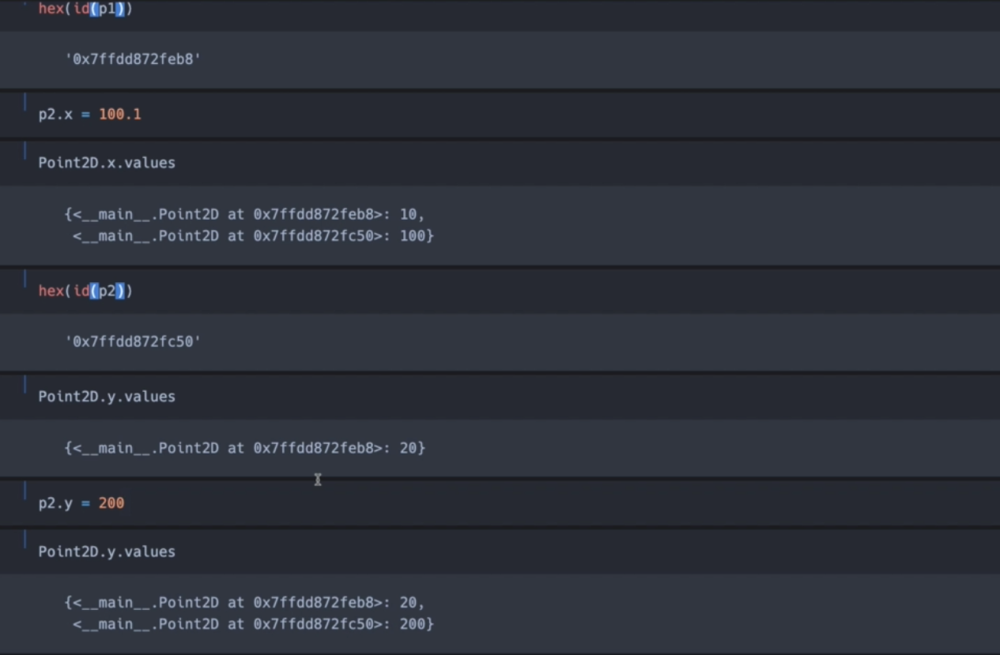

### It assumes objects are hasable 
- dunder eq
- dunder hash 
to become hashable

## PROBLEM
- memory leak:  dictionary in descriptor instance is storing a reference to the same object e.g. p1 and p2. Are referenced as keys in dictionary! If we delete p1 then we didn't actually destroyed the object!

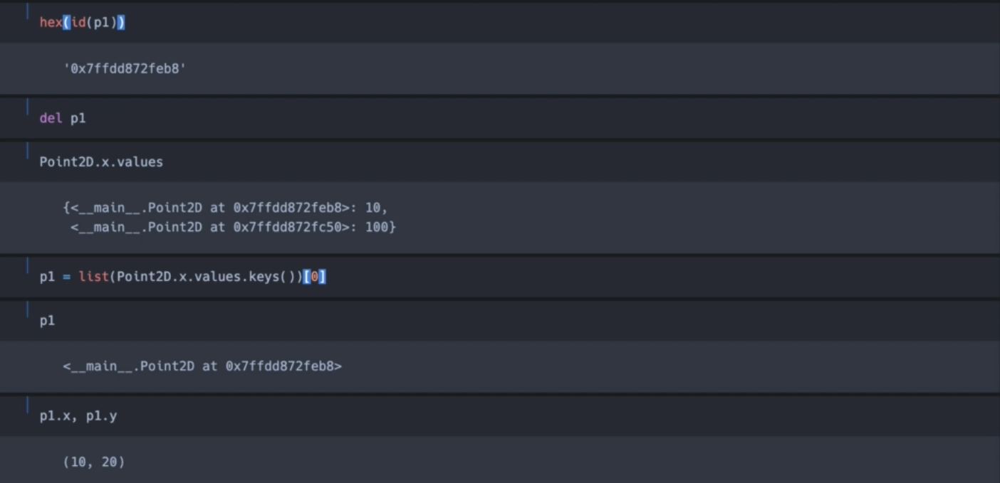

## REFERENCE COUNT OF OBJECT!!!!

In [10]:
import ctypes

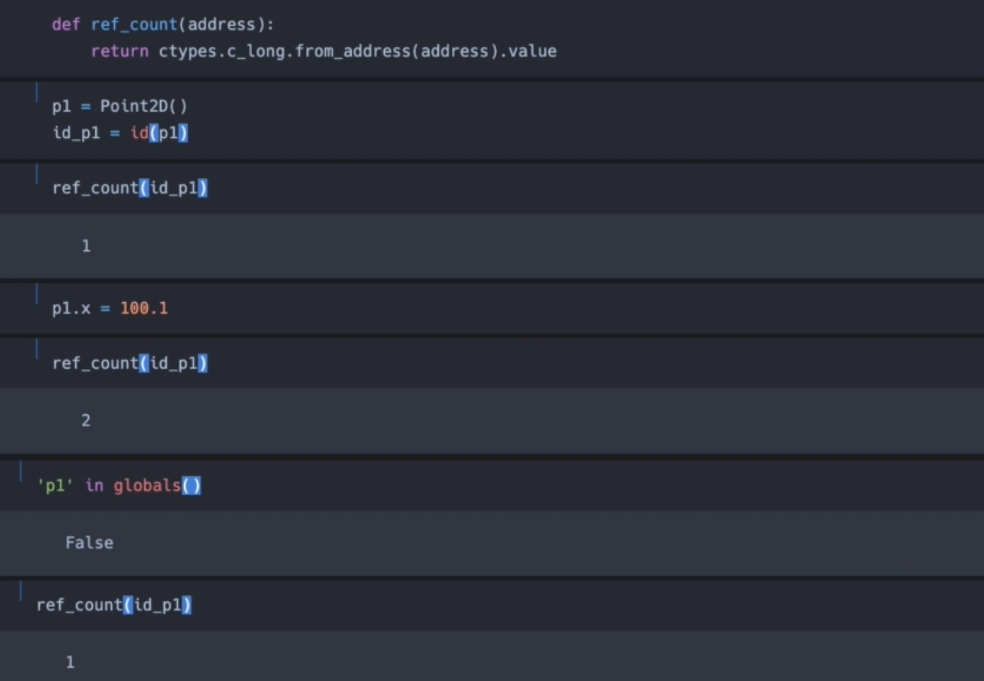

id_p1 is NOT a reference to p1!!! It is a reference to an integer object that happens to be the ID of p1

after the line p1.x = 100.1 the ref_count is 2 because p1 is referenced inside the dictionary!

### SOLUTION: weak references!

problem was that data descriptor was holding a strong reference to the object in its dictionary!

Solution: store a weakref instead in the dictionary of descriptors! Create weak references for our keys for our data descriptor

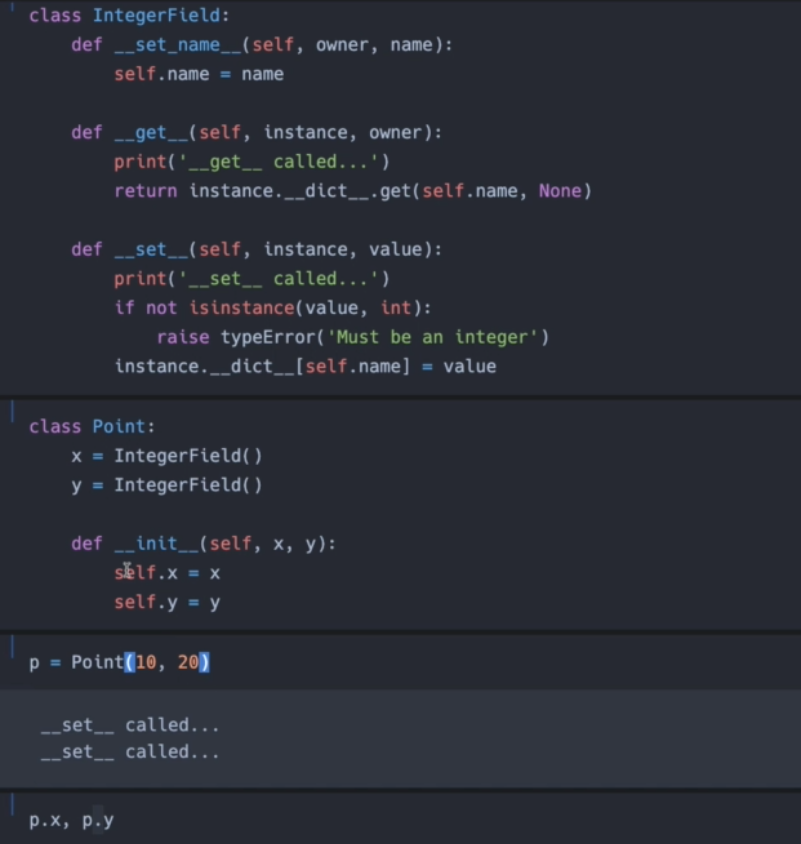

## Experimentation

In [ ]:
__set_name__

## Descriptors
#### https://www.youtube.com/watch?v=ovsvGtWD90Y&ab_channel=LivePython

In [3]:
class DescriptorClass:
    def __init__(self, initial_value = None, name='var'):
        self.val = initial_value
        self.name = name
        
    def __get__(self, obj, objtype):
        print('Getting element', self.name)
        return self.val
    
    def __set__(self, obj, val):
        print('Setting element', self.name)
        self.val = val

In [4]:
class SimpleClass:
    x = DescriptorClass(1, 'variable "x"')
    y = 2

In [5]:
s = SimpleClass()
print(s.x)
print('*'*10)
print(s.y)
print('*'*10)
s.x=777

Getting element variable "x"
1
**********
2
**********
Setting element variable "x"


### https://stackoverflow.com/questions/3798835/understanding-get-and-set-and-python-descriptors


#### Use cases:

- descriptor objects can be used as attributes on other object class definitions, **(That is, they live in the \__dict__ of the class object.)**
- Descriptor **lets you execute arbitrary code when reading or setting or deleting a value**
- Another use might be **refusing to accept a new value** by throwing an exception in \__set__ – effectively making the **"attribute" read only.** 
- Can cache expensive operation in it instead of the class. A data descriptor, like property, can allow for **lazy evaluation of attributes** based on a simpler state of the object, allowing **instances to use less memory than if you precomputed each possible attribute.**
- Another data descriptor, a member_descriptor, created by \__slots__ , allow memory savings by allowing the class to store data in a mutable tuple-like datastructure instead of the more flexible but space-consuming \__dict__
- A popular use for descriptors is managing access to instance data. The descriptor is assigned to a public attribute in the class dictionary while the actual data is stored as a private attribute in the instance dictionary. The descriptor’s \__get__() and \__set__() methods are triggered when the public attribute is accessed.
- Is it the python version of getter and setter.

In [1]:
class Celsius(object):
    def __init__(self, value=0.0):
        self.value = float(value)
    def __get__(self, instance, owner): 
        # self is the descriptor instance
        # instance is the instance of the class (would be temp) that the descriptor is in
        # owner is the class with the descriptor (would be Temperature)
        return self.value
    def __set__(self, instance, value):
        self.value = float(value)


class Temperature(object):
    celsius = Celsius()

In [2]:
temp=Temperature()
temp.celsius #calls celsius.__get__

0.0

instance in __get__ is the instance of the class (so above, __get__ would receive temp, while owner is the class with the descriptor (so it would be Temperature)

You need to use a descriptor class to encapsulate the logic that powers it. That way, **if the descriptor is used to cache some expensive operation (for example), it could store the value on itself and not its class**

if you simply try Temperature.celsius, instance will be None.

self is the descriptor instance, instance is the instance of the class (if instantiated) the descriptor is in (instance.__class__ is owner

A descriptor is defined on a class, but is typically called from an instance. When it's called from an instance both instance and owner are set (and you can work out owner from instance so it seems kinda pointless). But when called from a class, only owner is set – which is why it's there

This is only needed for __get__ because it's the only one that can be called on a class. If you set the class value you set the descriptor itself. Similarly for deletion. Which is why the owner isn't needed there.

In [6]:
class Celsius:

    def __get__(self, instance, owner):
        return 5 * (instance.fahrenheit - 32) / 9

    def __set__(self, instance, value):
        instance.fahrenheit = 32 + 9 * value / 5


class Temperature:

    celsius = Celsius()

    def __init__(self, initial_f):
        self.fahrenheit = initial_f
        
t = Temperature(212)
print(t.celsius)
t.celsius = 0
print(t.fahrenheit)

100.0
32.0


### https://docs.python.org/3/howto/descriptor.html

In [7]:
class Ten:
    def __get__(self, obj, objtype=None):
        return 10
    
class A:
    x = 5                       # Regular class attribute
    y = Ten()                   # Descriptor instance

In [8]:
a = A()     # Make an instance of class A
a.x         # Normal attribute lookup

5

In [9]:
a.y         # Descriptor lookup

10

#### Note that the value 10 is not stored in either the class dictionary or the instance dictionary. Instead, the value 10 is computed on demand

#### Interesting descriptors typically run computations instead of returning constants:

In [ ]:
import os

class DirectorySize:

    def __get__(self, obj, objtype=None):
        return len(os.listdir(obj.dirname))

class Directory:

    size = DirectorySize()              # Descriptor instance

    def __init__(self, dirname):
        self.dirname = dirname          # Regular instance attribute

An interactive session shows that the lookup is dynamic — it computes different, updated answers each time:

In [ ]:
s = Directory('songs')
g = Directory('games')
s.size                              # The songs directory has twenty files
20
g.size                              # The games directory has three files
3
open('games/newfile').close()       # Add a fourth file to the directory
g.size                              # File count is automatically updated

Besides showing how descriptors can run computations, this example also reveals the purpose of the parameters to __get__(). The self parameter is size, an instance of DirectorySize. The obj parameter is either g or s, an instance of Directory. It is the obj parameter that lets the __get__() method learn the target directory. The objtype parameter is the class Directory.

In [16]:
import logging

logging.basicConfig(level=logging.INFO)

class LoggedAgeAccess:

    def __get__(self, obj, objtype=None):
        value = obj._age
        logging.info('Accessing %r giving %r', 'age', value)
        return value

    def __set__(self, obj, value):
        logging.info('Updating %r to %r', 'age', value)
        obj._age = value

class Person:

    age = LoggedAgeAccess()             # Descriptor instance

    def __init__(self, name, age):
        self.name = name                # Regular instance attribute
        self.age = age                  # Calls __set__()

    def birthday(self):
        self.age += 1                   # Calls both __get__() and __set__()

In [17]:
Person.age

AttributeError: 'NoneType' object has no attribute '_age'

In [18]:
p = Person(name='Theo', age=33)

INFO:root:Updating 'age' to 33


In [19]:
Person.age

AttributeError: 'NoneType' object has no attribute '_age'

In [20]:
p.age

INFO:root:Accessing 'age' giving 33


33

In [21]:
Person.age

AttributeError: 'NoneType' object has no attribute '_age'

### See also @property (decorator)

### It is anything that implements the \__get__, \__set__ , \__delete protocol

In [58]:
class Person:
    def __new__(cls, *args, **kwargs):
        print('new person created')
        
        # see https://www.geeksforgeeks.org/__new__-in-python/
        #return super(Person, cls).__new__(cls, *args, **kwargs)  --> TypeError: object.__new__() takes exactly one argument (the type to instantiate)
        return super(Person, cls).__new__(cls)
    
    
    def __init__(self, *args, **kwargs):
        print('person is initialized with args={} and kwargs={}'.format(args, kwargs))
        for arg in args:
            self.__dict__[arg] = args[arg]
        for kwarg in kwargs:
            self.__dict__[kwarg] = kwargs[kwarg]
        
        
    def __get__(self, attr):
        print('getting attribute')
        try:
            return self.attr
        except:
            print('self.{} does not exist'.format(attr))
    
    def __set__(self, atrr, value):
        print('setting attribute')
        try:
            self.attr = value
        except:
            print('self.{} does not exist'.format(attr))

In [59]:
p = Person(**{'age':33, 'name':'Theo'})

new person created
person is initialized with args=() and kwargs={'age': 33, 'name': 'Theo'}


In [60]:
p.__dict__

{'age': 33, 'name': 'Theo'}

In [61]:
p.age

33

In [62]:
p.name

'Theo'

In [63]:
p.health

AttributeError: 'Person' object has no attribute 'health'